In [1]:
import time

import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML
%matplotlib inline

from util import display_image

## template matching
- try to match the target img by sliding window
- method
    - cv.TM_SQDIFF: 0 for perfect match
    - cv.TM_CCORR: 0 for worst match (large is better)
    - cv.TM_CCOEFF: 1 for perfect match, -1 for worst match, 0 for no correlation

In [2]:
def plot_images(img_list, cmap=None):
    def init():
        img.set_data(img_list[0])
        return (img,)

    def animate(i):
        img.set_data(img_list[i])
        return (img,)

    fig, ax = plt.subplots(1, 1)
    img = ax.imshow(img_list[0], cmap=cmap)
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=len(img_list), interval=50, blit=True)
    
    return HTML(anim.to_jshtml())

In [3]:
img = cv.imread('../img/figures.jpg')
template = cv.imread('../img/taekwonv1.jpg')

th, tw = template.shape[:2]

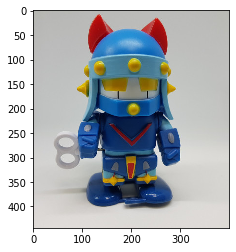

In [4]:
display_image(template)

In [5]:
methods = ['cv.TM_CCOEFF_NORMED', 'cv.TM_CCORR_NORMED', 'cv.TM_SQDIFF_NORMED']

In [6]:
for i, method_name in enumerate(methods):
    img_draw = img.copy()
    method = eval(method_name)
    # template matching
    res = cv.matchTemplate(img, template, method)
    # min, max val and find the position
    min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)
    print(method_name, min_val, max_val, min_loc, max_loc)

    if method in [cv.TM_SQDIFF, cv.TM_SQDIFF_NORMED]:
        top_left = min_loc
        match_val = min_val
    else:
        top_left = max_loc
        match_val = max_val
        
    # add rectangle to the matched point
    bottom_right = (top_left[0]+tw, top_left[1]+th)
    cv.rectangle(img_draw, top_left, bottom_right, (0, 0, 255), 2)
    # put texts on the point
    cv.putText(img_draw, str(match_val), top_left, cv.FONT_HERSHEY_PLAIN, 2, (0, 255, 0), 1, cv.LINE_AA)

cv.TM_CCOEFF_NORMED -0.1780252307653427 0.5131933093070984 (42, 0) (208, 43)
cv.TM_CCORR_NORMED 0.827332615852356 0.9238022565841675 (85, 6) (208, 43)
cv.TM_SQDIFF_NORMED 0.17028295993804932 0.36860838532447815 (208, 43) (86, 7)


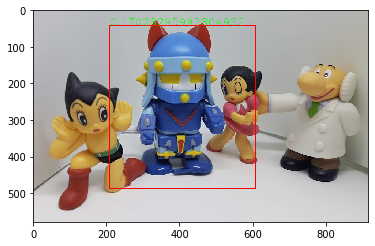

In [7]:
display_image(img_draw)

## corner detection
- corner: point that two edges are met

### harris corner detection
- find edges by Sobel gradient
- measure angle between two edges
- detect point as a corner if the gradient changes greatly along both x and y axis

In [8]:
img = cv.imread('../img/house.jpg')
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

In [9]:
# harris corner detection
# 2 for block size
# 3 for kernel size
# 0.04 for corner dection constant (empirical; 0.04~0.06)
corner = cv.cornerHarris(gray, 2, 3, 0.04)

In [10]:
coord = np.where(corner > 0.1*corner.max())
coord = np.stack(([coord[1], coord[0]]), axis=-1)

In [11]:
for x, y in coord:
    cv.circle(img, (x, y), 5, (0, 0, 255), 1, cv.LINE_AA)

In [12]:
corner_norm = cv.normalize(corner, None, 0, 255, cv.NORM_MINMAX, cv.CV_8U)

In [13]:
corner_norm = cv.cvtColor(corner_norm, cv.COLOR_GRAY2BGR)

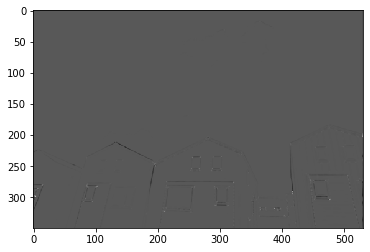

In [14]:
display_image(corner_norm)

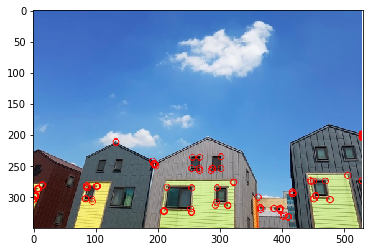

In [15]:
display_image(img)

### Shi, Tomasi
- improves harris corner detection
- cv.goodFeaturesToTrack(img, maxCorners, qualityLevel,    
    minDistance\[, corners, mask, blockSize, useHarrisDetector, k\])
    - maxCorners: the number of corners to get
    - qualityLevel: threshold for detecting corner
    - minDistance: distance between corners
    - mask: mask to excepting as a corner

In [16]:
img = cv.imread('../img/house.jpg')
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

In [17]:
corners = cv.goodFeaturesToTrack(gray, 80, 0.01, 10)
# float to int
corners = np.int32(corners)

In [18]:
for corner in corners:
    x, y = corner[0]
    cv.circle(img, (x, y), 5, (0, 0, 255), 1, cv.LINE_AA)

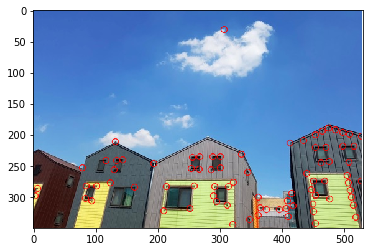

In [19]:
display_image(img)

## object tracking

### background subtractor

In [34]:
cap = cv.VideoCapture('../img/walking.avi')

In [35]:
# number of frames
fps = cap.get(cv.CAP_PROP_FPS)
print(fps)

10.0


In [36]:
delay = int(1000/fps)

In [37]:
fgbg = cv.createBackgroundSubtractorMOG2()

In [38]:
imgs = []
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
        
    fgmask = fgbg.apply(frame)
    imgs.append(fgmask)

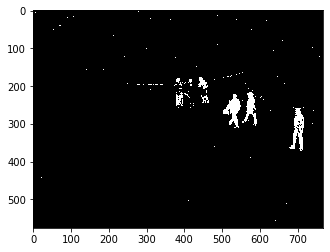

In [39]:
plot_images(imgs[:50], cmap='gray')

### sparse optical flow (lucas-kanade)

In [40]:
cap = cv.VideoCapture('../img/walking.avi')
fps = cap.get(cv.CAP_PROP_FPS)
delay = int(1000/fps)

In [41]:
# line colors to tracking
color = np.random.randint(0, 255, (200, 3))
lines = None
prevImg = None
# stopping criterion
termcriteria = (cv.TERM_CRITERIA_EPS | cv.TERM_CRITERIA_COUNT, 10, 0.03)

In [42]:
imgs = []

In [43]:
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    img_draw = frame.copy()
    gray = cv.cvtColor(frame, cv.COLOR_BGR2GRAY)
    # first frame
    if prevImg is None:
        prevImg = gray
        lines = np.zeros_like(frame)
        # corner detection for initialize tracking
        prevPt = cv.goodFeaturesToTrack(prevImg, 200, 0.01, 10)
    else:
        nextImg = gray
        # corner detection from optical flow
        nextPt, status, err = cv.calcOpticalFlowPyrLK(prevImg, nextImg,
                                                      prevPt, None, criteria=termcriteria)
    
        prevMv = prevPt[status == 1]
        nextMv = nextPt[status == 1]
        for i, (p, n) in enumerate(zip(prevMv, nextMv)):
            px, py = p.ravel()
            nx, ny = n.ravel()
            
            cv.line(lines, (px, py), (nx, ny), color[i].tolist(), 2)
            cv.circle(img_draw, (nx, ny), 2, color[i].tolist(), -1)
            
        img_draw = cv.add(img_draw, lines)
        prevImg = nextImg
        prevPt = nextPt.reshape(-1, 1, 2)
        
    imgs.append(img_draw)

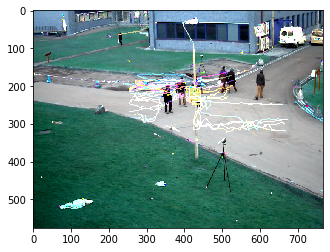

In [44]:
plot_images(imgs[:100])